In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

In [2]:
df = pd.read_csv("Datasets/Electric Vehicle Sales by State in India.csv")

In [3]:
df.head()

,Year,Month_Name,Date,State,Vehicle_Class,Vehicle_Category,Vehicle_Type,EV_Sales_Quantity
0,2014.0,jan,1/1/2014,Andhra Pradesh,ADAPTED VEHICLE,Others,Others,0.0
1,2014.0,jan,1/1/2014,Andhra Pradesh,AGRICULTURAL TRACTOR,Others,Others,0.0
2,2014.0,jan,1/1/2014,Andhra Pradesh,AMBULANCE,Others,Others,0.0
3,2014.0,jan,1/1/2014,Andhra Pradesh,ARTICULATED VEHICLE,Others,Others,0.0
4,2014.0,jan,1/1/2014,Andhra Pradesh,BUS,Bus,Bus,0.0


In [4]:
df["State"].value_counts()

State
Maharashtra                 4912
Karnataka                   4830
Uttar Pradesh               4557
Rajasthan                   4552
Gujarat                     4517
West Bengal                 4196
Tamil Nadu                  4063
Odisha                      4027
Haryana                     3842
Kerala                      3666
Chhattisgarh                3590
Madhya Pradesh              3587
Andhra Pradesh              3457
Assam                       3114
Uttarakhand                 3045
Himachal Pradesh            2980
Punjab                      2950
Jharkhand                   2773
Bihar                       2544
Jammu and Kashmir           2292
Arunachal Pradesh           2285
Goa                         2139
DNH and DD                  1927
Delhi                       1871
Meghalaya                   1867
Puducherry                  1832
Manipur                     1632
Nagaland                    1588
Tripura                     1564
Mizoram                     1557
Chan

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96845 entries, 0 to 96844
Data columns (total 8 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Year               96845 non-null  float64
 1   Month_Name         96845 non-null  object 
 2   Date               96845 non-null  object 
 3   State              96845 non-null  object 
 4   Vehicle_Class      96845 non-null  object 
 5   Vehicle_Category   96845 non-null  object 
 6   Vehicle_Type       96845 non-null  object 
 7   EV_Sales_Quantity  96845 non-null  float64
dtypes: float64(2), object(6)
memory usage: 5.9+ MB


In [6]:
df.duplicated().sum()

0

In [7]:
df["Vehicle_Category"].value_counts()

Vehicle_Category
Others        54423
2-Wheelers    13121
3-Wheelers    11491
Bus            9119
4-Wheelers     8691
Name: count, dtype: int64

In [8]:
df["Vehicle_Type"].value_counts()

Vehicle_Type
Others                54423
2W_Personal           11700
Bus                    7026
4W_Shared              4580
4W_Personal            4111
3W_Shared              3786
3W_Goods               3208
Institution Bus        2093
3W_Shared_LowSpeed     1951
3W_Goods_LowSpeed      1517
2W_Shared              1421
3W_Personal            1029
Name: count, dtype: int64

In [9]:
df["EV_Sales_Quantity"].value_counts()

EV_Sales_Quantity
0.0        82783
1.0         2481
2.0         1138
3.0          775
4.0          549
           ...  
3039.0         1
2353.0         1
955.0          1
10506.0        1
5380.0         1
Name: count, Length: 1447, dtype: int64

In [10]:
df["Date"] = pd.to_datetime(df["Date"])

In [11]:
df.insert(2, "Day" ,df["Date"].dt.day)

In [12]:
df.insert(3, "Month" ,df["Date"].dt.month)

In [13]:
df.head()

,Year,Month_Name,Day,Month,Date,State,Vehicle_Class,Vehicle_Category,Vehicle_Type,EV_Sales_Quantity
0,2014.0,jan,1,1,2014-01-01,Andhra Pradesh,ADAPTED VEHICLE,Others,Others,0.0
1,2014.0,jan,1,1,2014-01-01,Andhra Pradesh,AGRICULTURAL TRACTOR,Others,Others,0.0
2,2014.0,jan,1,1,2014-01-01,Andhra Pradesh,AMBULANCE,Others,Others,0.0
3,2014.0,jan,1,1,2014-01-01,Andhra Pradesh,ARTICULATED VEHICLE,Others,Others,0.0
4,2014.0,jan,1,1,2014-01-01,Andhra Pradesh,BUS,Bus,Bus,0.0


In [14]:
df["State"].value_counts()

State
Maharashtra                 4912
Karnataka                   4830
Uttar Pradesh               4557
Rajasthan                   4552
Gujarat                     4517
West Bengal                 4196
Tamil Nadu                  4063
Odisha                      4027
Haryana                     3842
Kerala                      3666
Chhattisgarh                3590
Madhya Pradesh              3587
Andhra Pradesh              3457
Assam                       3114
Uttarakhand                 3045
Himachal Pradesh            2980
Punjab                      2950
Jharkhand                   2773
Bihar                       2544
Jammu and Kashmir           2292
Arunachal Pradesh           2285
Goa                         2139
DNH and DD                  1927
Delhi                       1871
Meghalaya                   1867
Puducherry                  1832
Manipur                     1632
Nagaland                    1588
Tripura                     1564
Mizoram                     1557
Chan

In [15]:
df["Year"]

0        2014.0
1        2014.0
2        2014.0
3        2014.0
4        2014.0
          ...  
96840    2023.0
96841    2023.0
96842    2023.0
96843    2023.0
96844    2023.0
Name: Year, Length: 96845, dtype: float64

C:\Users\jayde\AppData\Local\Temp\ipykernel_10164\3014068524.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = tmp.index , y = tmp.values,palette='rocket')


<Axes: xlabel='Year'>

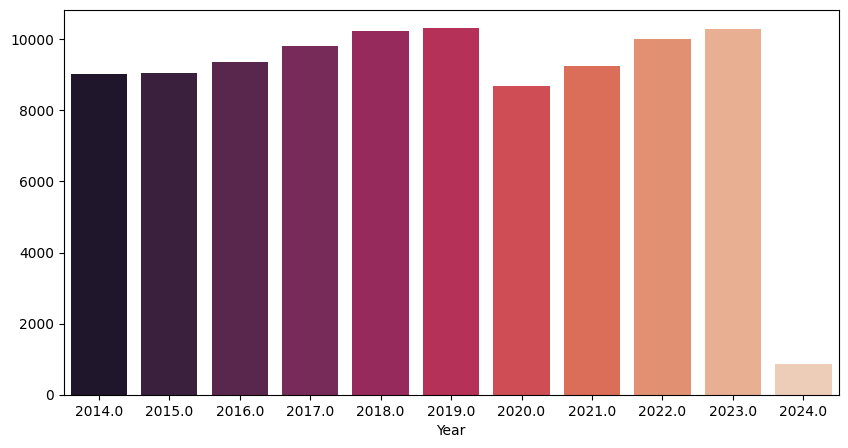

In [16]:
tmp = df.groupby("Year")["EV_Sales_Quantity"].count()
plt.figure(figsize = (10,5))
sns.barplot(x = tmp.index , y = tmp.values,palette='rocket')

C:\Users\jayde\AppData\Local\Temp\ipykernel_10164\1065591869.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = tmp.index , y = tmp.values,palette='mako')


<Axes: xlabel='Month_Name'>

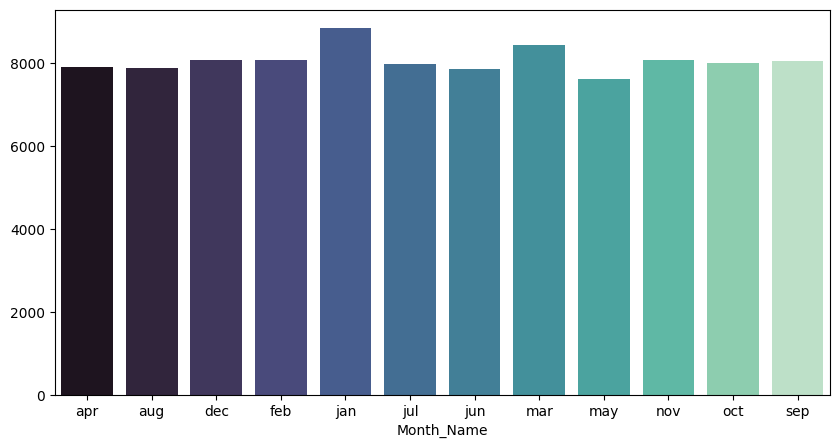

In [17]:
tmp = df.groupby("Month_Name")["EV_Sales_Quantity"].count()
plt.figure(figsize = (10,5))
sns.barplot(x = tmp.index , y = tmp.values,palette='mako')

C:\Users\jayde\AppData\Local\Temp\ipykernel_10164\403920776.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x = tmp.index , y = tmp.values,palette='icefire')


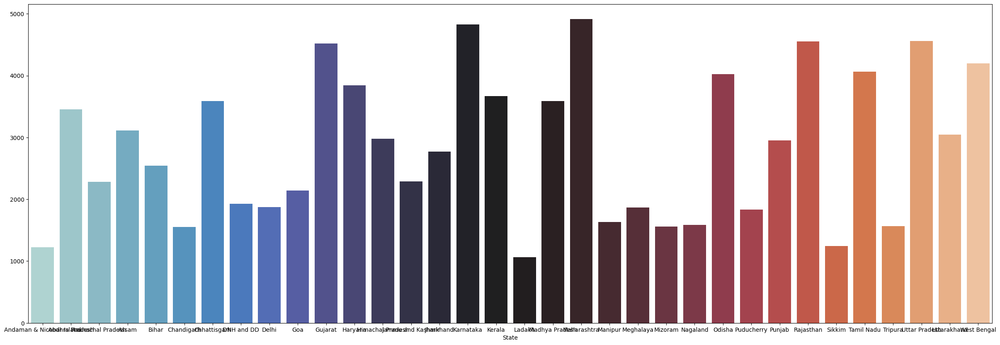

In [19]:
tmp = df.groupby("State")["EV_Sales_Quantity"].count()
plt.figure(figsize = (30,10))
ax = sns.barplot(x = tmp.index , y = tmp.values,palette='icefire')

In [20]:
df.head()

,Year,Month_Name,Day,Month,Date,State,Vehicle_Class,Vehicle_Category,Vehicle_Type,EV_Sales_Quantity
0,2014.0,jan,1,1,2014-01-01,Andhra Pradesh,ADAPTED VEHICLE,Others,Others,0.0
1,2014.0,jan,1,1,2014-01-01,Andhra Pradesh,AGRICULTURAL TRACTOR,Others,Others,0.0
2,2014.0,jan,1,1,2014-01-01,Andhra Pradesh,AMBULANCE,Others,Others,0.0
3,2014.0,jan,1,1,2014-01-01,Andhra Pradesh,ARTICULATED VEHICLE,Others,Others,0.0
4,2014.0,jan,1,1,2014-01-01,Andhra Pradesh,BUS,Bus,Bus,0.0


C:\Users\jayde\AppData\Local\Temp\ipykernel_10164\527547193.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = tmp.index , y = tmp.values,palette='rocket')


<Axes: xlabel='Vehicle_Category'>

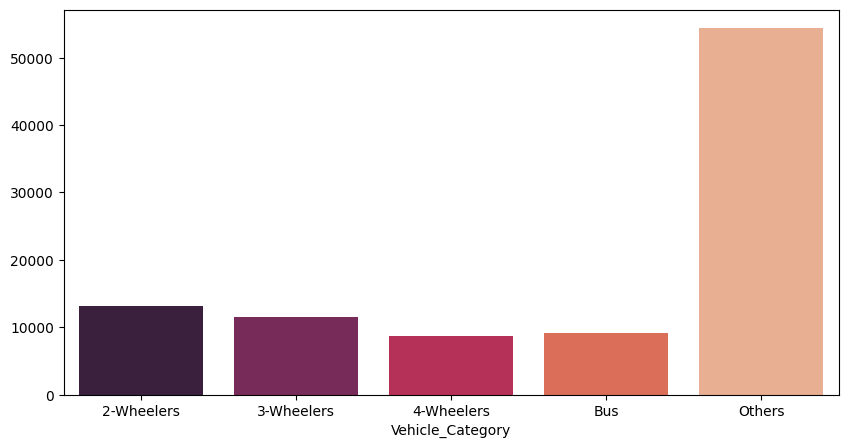

In [21]:
tmp = df.groupby("Vehicle_Category")["EV_Sales_Quantity"].count()
plt.figure(figsize = (10,5))
sns.barplot(x = tmp.index , y = tmp.values,palette='rocket')

In [22]:
df.head()

,Year,Month_Name,Day,Month,Date,State,Vehicle_Class,Vehicle_Category,Vehicle_Type,EV_Sales_Quantity
0,2014.0,jan,1,1,2014-01-01,Andhra Pradesh,ADAPTED VEHICLE,Others,Others,0.0
1,2014.0,jan,1,1,2014-01-01,Andhra Pradesh,AGRICULTURAL TRACTOR,Others,Others,0.0
2,2014.0,jan,1,1,2014-01-01,Andhra Pradesh,AMBULANCE,Others,Others,0.0
3,2014.0,jan,1,1,2014-01-01,Andhra Pradesh,ARTICULATED VEHICLE,Others,Others,0.0
4,2014.0,jan,1,1,2014-01-01,Andhra Pradesh,BUS,Bus,Bus,0.0


In [23]:
pd.crosstab(df["Year"] , df["Month_Name"] , normalize = "columns")*100

Month_Name,apr,aug,dec,feb,jan,jul,jun,mar,may,nov,oct,sep
Year,,,,,,,,,,,,
2014.0,9.485916,9.511145,9.224864,9.353320,8.595956,9.420018,9.589913,9.140486,9.813697,9.247338,9.105650,9.423173
2015.0,9.296451,9.675785,9.274393,9.489594,8.347453,9.482651,9.386144,9.045643,10.049856,9.507304,9.292753,9.472899
2016.0,9.751168,9.701114,9.732541,9.588702,8.268384,9.557810,10.201223,9.614701,10.522173,9.643476,9.829113,9.622079
2017.0,10.155362,10.169706,10.364042,9.762141,8.833164,10.397094,10.354050,10.397155,10.653372,10.423372,10.103530,9.957732
2018.0,10.862701,10.473658,10.611689,10.530228,9.612561,10.660153,10.812532,10.385299,11.335607,10.559544,10.552576,10.454998
2019.0,10.913225,10.714286,10.500248,10.406343,9.657743,11.111111,11.003566,10.349733,11.493046,10.559544,10.664837,10.616609
2020.0,8.437539,8.257345,9.608717,10.777998,9.849768,8.054616,7.603158,11.061055,5.457885,9.160683,9.392541,9.385878
2021.0,9.738537,9.941743,9.843982,9.836472,8.629843,9.870976,9.156903,9.697688,8.199948,9.631097,9.991269,10.082049
2022.0,10.711128,10.714286,10.289747,9.960357,9.047780,10.597520,10.888945,9.922940,11.138809,10.485269,10.328053,10.305818


<Axes: xlabel='Month_Name', ylabel='Year'>

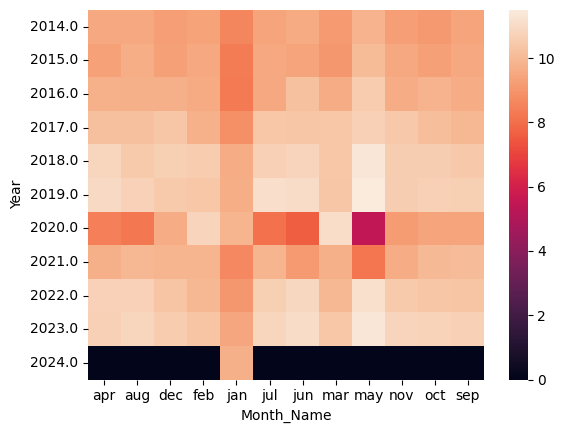

In [24]:
sns.heatmap(pd.crosstab(df["Year"] , df["Month_Name"] , normalize = "columns")*100)

In [25]:
pd.crosstab(df["Year"] , df["Vehicle_Category"] , normalize = "columns")*100

Vehicle_Category,2-Wheelers,3-Wheelers,4-Wheelers,Bus,Others
Year,,,,,
2014.0,8.253944,7.205639,10.171442,10.494572,9.683406
2015.0,8.444478,7.466713,10.194454,10.308148,9.665031
2016.0,9.198994,8.406579,9.860776,10.352012,9.874502
2017.0,10.098316,9.729353,9.883788,10.680996,10.148283
2018.0,10.845210,10.564790,10.113911,10.911284,10.499237
2019.0,10.807103,11.026020,9.941319,10.571335,10.660934
2020.0,9.877296,10.094857,9.446554,6.996381,8.746302
2021.0,10.098316,10.938996,9.561615,7.709179,9.431674
2022.0,10.685161,11.739622,9.872282,9.507621,10.188707


<Axes: xlabel='Vehicle_Category', ylabel='Year'>

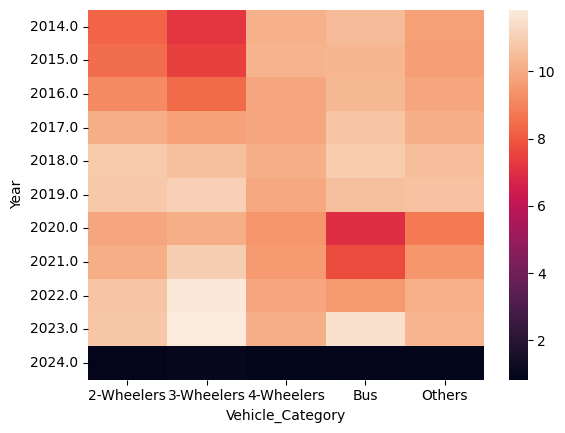

In [26]:
sns.heatmap(pd.crosstab(df["Year"] , df["Vehicle_Category"] , normalize = "columns")*100)

In [27]:
df.head()

,Year,Month_Name,Day,Month,Date,State,Vehicle_Class,Vehicle_Category,Vehicle_Type,EV_Sales_Quantity
0,2014.0,jan,1,1,2014-01-01,Andhra Pradesh,ADAPTED VEHICLE,Others,Others,0.0
1,2014.0,jan,1,1,2014-01-01,Andhra Pradesh,AGRICULTURAL TRACTOR,Others,Others,0.0
2,2014.0,jan,1,1,2014-01-01,Andhra Pradesh,AMBULANCE,Others,Others,0.0
3,2014.0,jan,1,1,2014-01-01,Andhra Pradesh,ARTICULATED VEHICLE,Others,Others,0.0
4,2014.0,jan,1,1,2014-01-01,Andhra Pradesh,BUS,Bus,Bus,0.0


In [28]:
df.drop(columns = ["Date" ,"Month_Name"] , inplace=True)

In [29]:
df["Year"] = df["Year"].astype(int)

In [30]:
df["EV_Sales_Quantity"] = df["EV_Sales_Quantity"].astype(int)

In [31]:
df.head()

,Year,Day,Month,State,Vehicle_Class,Vehicle_Category,Vehicle_Type,EV_Sales_Quantity
0,2014,1,1,Andhra Pradesh,ADAPTED VEHICLE,Others,Others,0
1,2014,1,1,Andhra Pradesh,AGRICULTURAL TRACTOR,Others,Others,0
2,2014,1,1,Andhra Pradesh,AMBULANCE,Others,Others,0
3,2014,1,1,Andhra Pradesh,ARTICULATED VEHICLE,Others,Others,0
4,2014,1,1,Andhra Pradesh,BUS,Bus,Bus,0


In [32]:
le = LabelEncoder()

In [33]:
temp = df[["Year","State" , "Vehicle_Class" , "Vehicle_Category" , "Vehicle_Type"]]
for col in temp.columns:
    df[col] = le.fit_transform(df[col])

In [34]:
df.head()

,Year,Day,Month,State,Vehicle_Class,Vehicle_Category,Vehicle_Type,EV_Sales_Quantity
0,0,1,1,1,0,4,11,0
1,0,1,1,1,1,4,11,0
2,0,1,1,1,2,4,11,0
3,0,1,1,1,5,4,11,0
4,0,1,1,1,9,3,9,0


In [35]:
df = df.drop(columns = ["Day" , "Month"])

In [36]:
sc = StandardScaler()
for i in df.iloc[:-1]: 
    df[i] = sc.fit_transform(df[i].values.reshape(-1,1))

In [37]:
df_copy = df.copy()

In [38]:
lst = []

for i in range(1,11):
    kmeans = KMeans(n_clusters=i)
    kmeans.fit(df)
    lst.append(kmeans.inertia_)

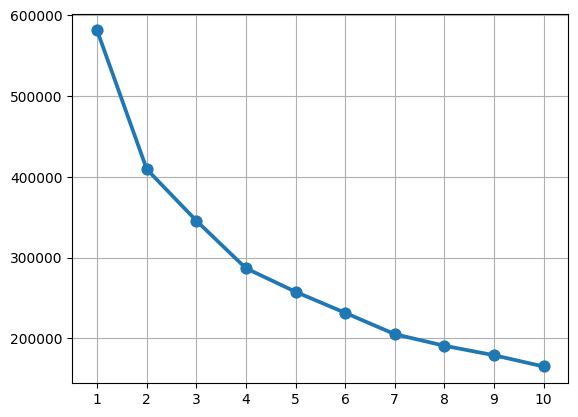

In [43]:
sns.pointplot(x = range(1,11) , y = lst)
plt.grid(True)

In [44]:
kmeans = KMeans(n_clusters = 2)
kmeans.fit(df)
kmeans.labels_
kmeans.cluster_centers_

array([[-0.0378532 ,  0.02073047, -0.194157  ,  0.58605202,  0.58396316,
        -0.08503926],
       [ 0.0917936 , -0.05027116,  0.47082867, -1.42116993, -1.41610447,
         0.2062193 ]])

In [45]:
pca = PCA(2)
pca_df = pca.fit_transform(df)
centers =  pca.transform(kmeans.cluster_centers_)

C:\Users\jayde\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(


In [46]:
centers

array([[ 0.85044708, -0.00684649],
       [-2.06232514,  0.01660267]])

In [47]:
pca_df[:,0]

array([ 1.53464455,  1.51844358,  1.50224261, ..., -0.11752632,
       -2.34553205, -1.86374897])

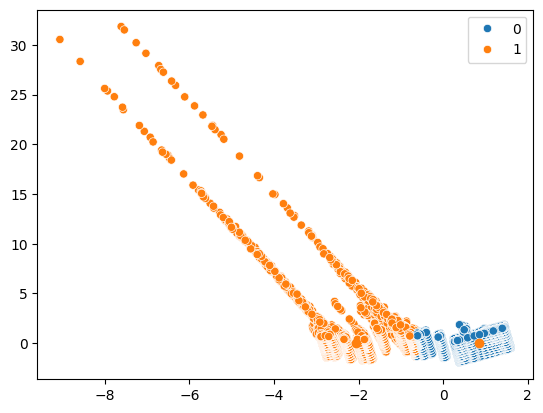

In [48]:
sns.scatterplot(x= pca_df[:,0] , y = pca_df[:,1] , hue = kmeans.labels_)
plt.scatter(centers[:,0] , centers[:,1] )

C:\Users\jayde\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(


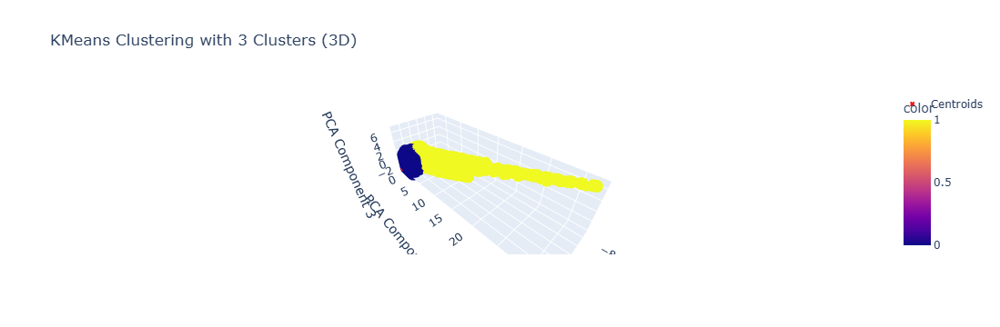

In [49]:
import plotly.express as px
labels = kmeans.labels_

pca_3d = PCA(n_components=3)
pca_df_3d = pca_3d.fit_transform(df)
centers_3d = pca_3d.transform(kmeans.cluster_centers_)

fig = px.scatter_3d(x=pca_df_3d[:, 0],y=pca_df_3d[:, 1],z=pca_df_3d[:, 2],color=labels,title="KMeans Clustering with 3 Clusters (3D)",
    labels={'x': 'PCA Component 1', 'y': 'PCA Component 2', 'z': 'PCA Component 3'})

# Add cluster centroids to the 3D plot
fig.add_scatter3d(
    x=centers_3d[:, 0],
    y=centers_3d[:, 1],
    z=centers_3d[:, 2],
    mode='markers',
    marker=dict(size=5, color='red', symbol='x'),
    name='Centroids'
)

fig.show()

In [50]:
df_copy["clusters"] = kmeans.labels_
data_pivot = df_copy.groupby('clusters').mean().T
data_pivot_mean = data_pivot.mean(axis=1).reset_index()
data_pivot_mean.columns = ['Variable', 'Value']

C:\Users\jayde\AppData\Local\Temp\ipykernel_10164\1169097951.py:4: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


C:\Users\jayde\AppData\Local\Temp\ipykernel_10164\1169097951.py:4: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




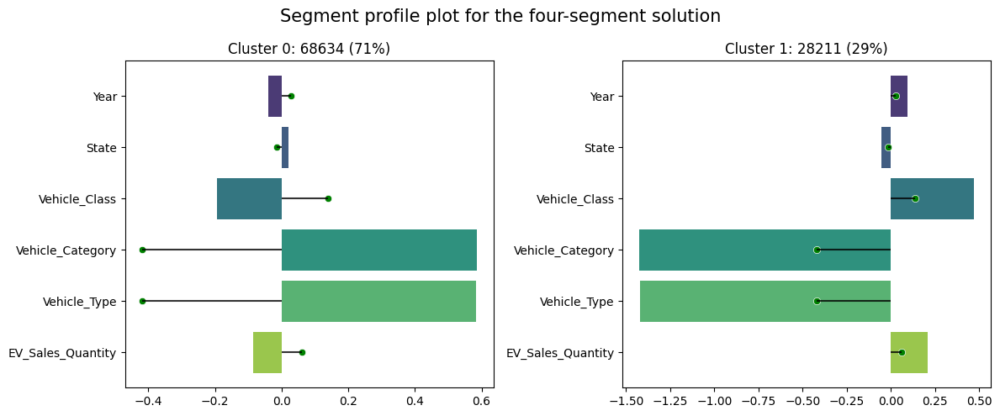

In [51]:
plt.figure(figsize = (12, 5))
for i in range(2):
    plt.subplot(1, 2, i+1)
    sns.barplot(data_pivot, x = i, y = data_pivot.index, palette='viridis')
    sns.scatterplot(data_pivot_mean, x = 'Value', y = 'Variable', color = 'green')
    for index, row in data_pivot_mean.iterrows():
        plt.hlines(y=row['Variable'], xmin=0, xmax=row['Value'], colors='black', alpha = 0.8)
    plt.ylabel("")
    plt.xlabel("")
    plt.title(f"Cluster {i}: {df_copy['clusters'].value_counts()[i]} ({df_copy['clusters'].value_counts()[i]*100/len(df_copy):.0f}%)")

plt.suptitle("Segment profile plot for the four-segment solution", fontsize = 15)
plt.tight_layout()
plt.show()


## ✅ Final Cluster Insights Summary

- **Cluster 0 (71%)**: Mass-market EV segment — dominated by 2W/3W or high-frequency sales vehicles in populous states. Best for affordability-focused marketing.
- **Cluster 1 (29%)**: Emerging or niche EV market — possibly 4W or commercial vehicles, fewer states, higher EV_Sales_Quantity. Ideal for targeting metro cities or commercial buyers.